Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


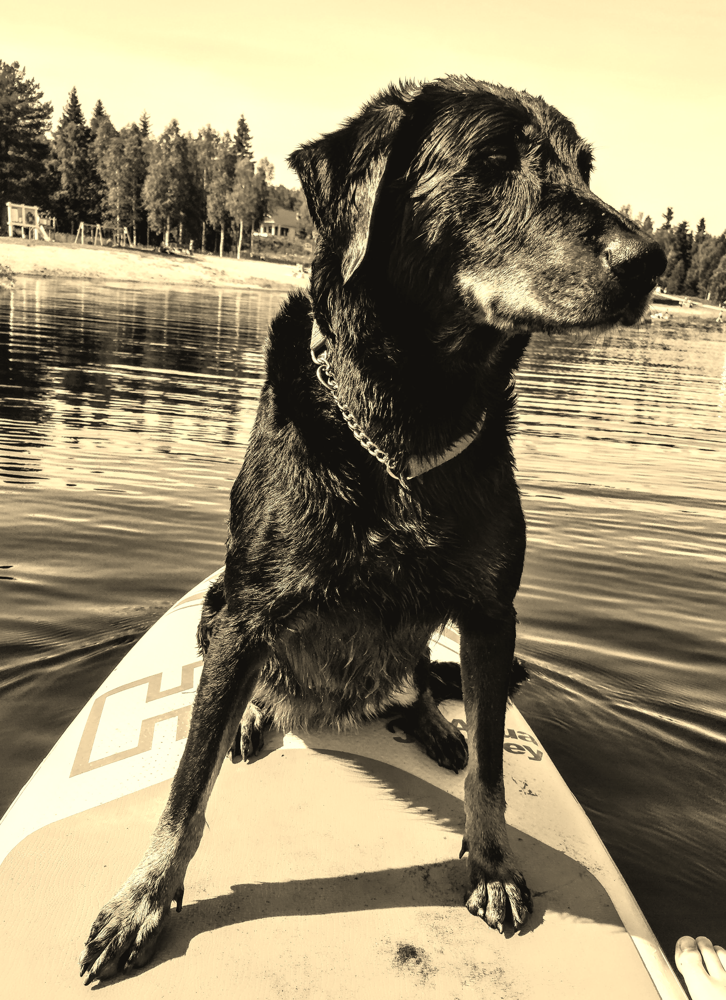

TypeError: ignored

In [2]:
from keras.models import load_model
from PIL import Image, ImageOps
from google.colab import drive
from tkinter import *   
import cv2
import numpy as np
from PIL import Image
from IPython.display import display

def sepia_np(image_path:str)->Image:
    """
    Optimization on the sepia filter using numpy 
    """

    image = Image.open(image_path)

    # Load the image as an array so cv knows how to work with it
    img = np.array(image)

    # Apply a transformation where we multiply each pixel 
    # rgb with the matrix transformation for the sepia

    lmap = np.matrix([[ 0.393, 0.769, 0.189],
                      [ 0.349, 0.686, 0.168],
                      [ 0.272, 0.534, 0.131]                                  
    ])

    filt = np.array([x * lmap.T for x in img] )

    # Check wich entries have a value greather than 255 and set it to 255
    filt[np.where(filt>255)] = 255

    # Create an image from the array
    return Image.fromarray(filt.astype('uint8'))

drive.mount('/content/drive')
image_path = '/content/drive/MyDrive/Pilvilaskenta2021_Noora_Angelva/Pilvi3Kuva/Emmi.jpg'
image = sepia_np(image_path)
display(image)
from google.colab import files
files.download(image)